In [1]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

import matplotlib as mpl
# enables correct plotting of text
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42 

import celltypist

In [2]:
# import session_info
# session_info.show()

In [3]:
import importlib.util
import sys
spec = importlib.util.spec_from_file_location("module.name", "/nfs/team205/kk18/function/python/utils.py")
utils = importlib.util.module_from_spec(spec)
sys.modules["module.name"] = utils
spec.loader.exec_module(utils)

In [4]:
sc.settings.set_figure_params(dpi=80)

# Variables

In [5]:
adata_dir = '/lustre/scratch126/cellgen/team205/kk18/VisiumHD/objects/subsets'
sample_id = 'HEA_FOET14880396'
celltype = 'VentricularCardiomyocytes'

In [6]:
figdir = '/nfs/team205/heart/fetal_ms_figures/raw_plots_kk/Aug2024'
table_dir = '/nfs/team205/heart/fetal_ms_figures/tables/Aug2024'

# Read in data

In [7]:
# read in
adata = sc.read_h5ad(f'{adata_dir}/{sample_id}_{celltype}_b2c_cells_filtered_lognorm.h5ad')
adata

AnnData object with n_obs × n_vars = 61075 × 17994
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'leiden_0.2', 'leiden_0.4', 'leiden_0.6', 'leiden_1', 'leiden_1.2', 'leiden_1.5', 'leiden_2'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'celltypist_co

# Remove mid-grain markers from the feature

In [8]:
# read in
midgrain_markers = pd.read_csv('/nfs/team205/kk18/notebooks/Foetal/VisiumHD/re-seq_mpp0p3/sc_midgrain_markers.csv',
                               index_col=0
                              )
# remove the markers of celltype of interest
midgrain_markers = midgrain_markers[midgrain_markers['group']!=celltype]
midgrain_markers

,group,names,scores,logfoldchanges,pvals,pvals_adj,group_mean
0,AtrialCardiomyocytes,MYH6,589.180000,8.461190,0.0,0.0,3.555969
1,AtrialCardiomyocytes,PAM,446.767100,5.372062,0.0,0.0,4.026159
2,AtrialCardiomyocytes,NPPA,444.359400,7.048445,0.0,0.0,4.366144
3,AtrialCardiomyocytes,MYL7,444.032530,5.999820,0.0,0.0,4.489749
4,AtrialCardiomyocytes,TNNT2,428.842380,4.739163,0.0,0.0,3.264460
...,...,...,...,...,...,...,...
102668,LymphoidCells,ADK,54.743217,1.088896,0.0,0.0,1.117559
102770,LymphoidCells,FCHSD2,51.053140,1.119463,0.0,0.0,1.309117
102785,LymphoidCells,SPIDR,50.689087,1.023158,0.0,0.0,1.011237
102788,LymphoidCells,IMMP2L,50.527325,1.016055,0.0,0.0,1.424370


In [9]:
'GATA2' in list(midgrain_markers['names'])

False

In [10]:
# remove
mask = [x not in list(midgrain_markers['names']) for x in adata.var_names]
bdata = adata[:,mask]
bdata

View of AnnData object with n_obs × n_vars = 61075 × 16746
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'leiden_0.2', 'leiden_0.4', 'leiden_0.6', 'leiden_1', 'leiden_1.2', 'leiden_1.5', 'leiden_2'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'cellt

# PCA, Clustering, UMAP

number of hvgs: 2241


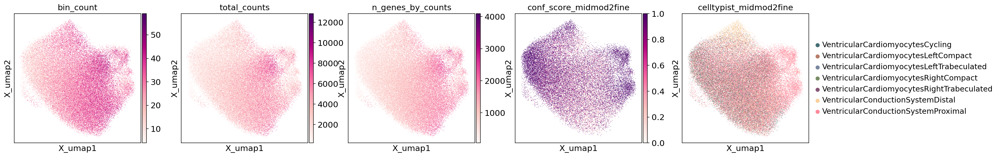

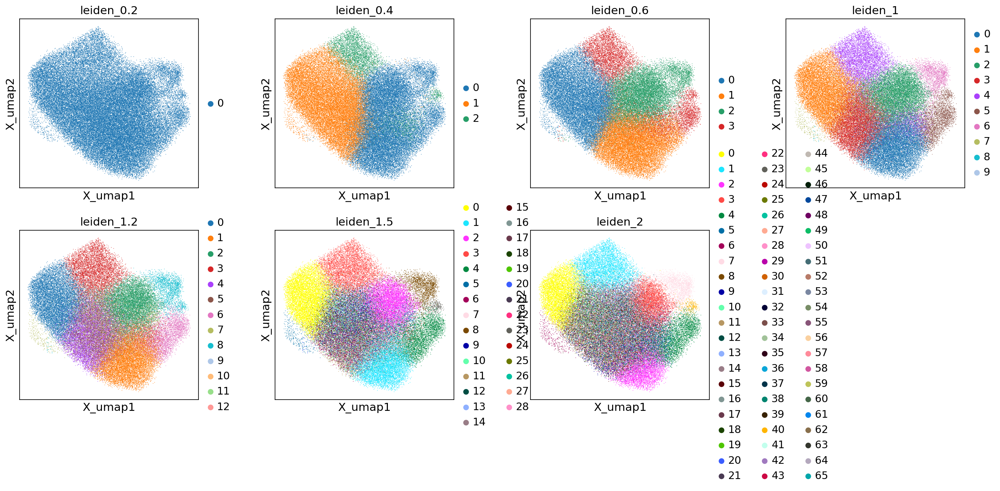

In [11]:
# HVGs, using the object which doesn't have midgrain markers
sc.pp.highly_variable_genes(bdata, flavor='seurat', min_mean=0.0125, max_mean=3, min_disp=0.5)
print(f'number of hvgs: {sum(bdata.var.highly_variable)}')
# PCA using the degected HVGs
sc.tl.pca(bdata, use_highly_variable=True)
adata.obsm['X_pca'] = bdata.obsm['X_pca'].copy()
# create neighbour graph
sc.pp.neighbors(adata,n_neighbors=15,use_rep='X_pca')
# visualisation with umap
sc.tl.umap(adata,min_dist=0.5)
sc.pl.embedding(adata,basis='X_umap',color=['bin_count','total_counts','n_genes_by_counts',"conf_score_midmod2fine","celltypist_midmod2fine",],
                wspace=0.2,cmap='RdPu',vmax='p100',ncols=5)
# leiden clustering
resolutions_list = [0.2,0.4,0.6,1,1.2,1.5,2]
for resolution in resolutions_list:
    sc.tl.leiden(adata,resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
sc.pl.embedding(adata,basis='X_umap',
                color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                wspace=0.3)

In [12]:
'HEY2' in adata.var_names

True

# Markers 

In [13]:
markers = {
    'VCSprox':['TBX3','PRDM16','NIBAN1','PHACTR1','FGF18'], # 'PRDM16','NIBAN1','PHACTR1','FGF18' are the markers compared to VCSdistal
    'VCSdist':['SEMA3A','IRX2','IRX3','OPCML','NTN1','EPHA4','GABRB2'],
    'Trab':['ADAMTSL1','SGCD','CSMD1'],
    'Compact':['TBX20','HEY2'],
    'Cycling':['MKI67','TOP2A']
}

genes = []
for g in markers.values():
    genes = genes + [x for x in g if (x in adata.var_names)&(x not in genes)]
for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]
len(genes)

18

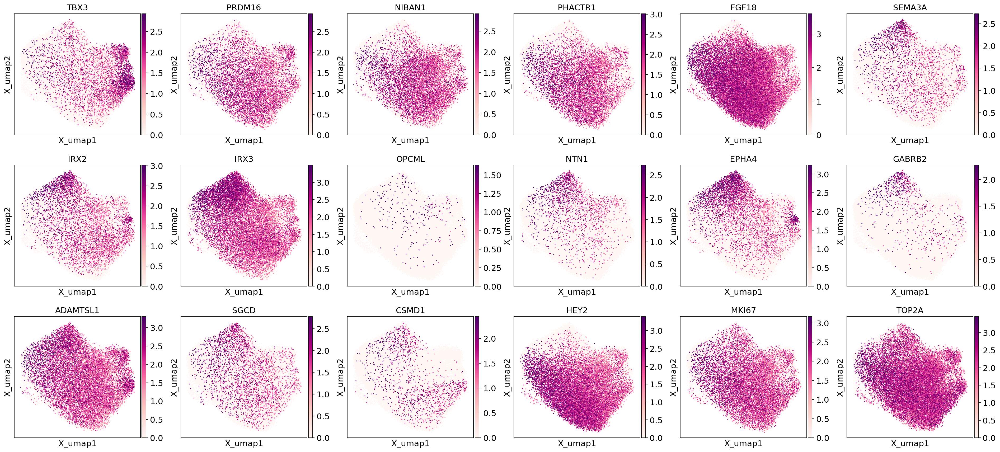

In [14]:
sc.pl.embedding(adata,basis='X_umap',color=genes, size=10,
               ncols=6, wspace=0.2,cmap='RdPu',vmax='p99.7')

In [15]:
resolution_sel = 1

categories: 0, 1, 2, etc.
var_group_labels: CM, FB, EC, etc.


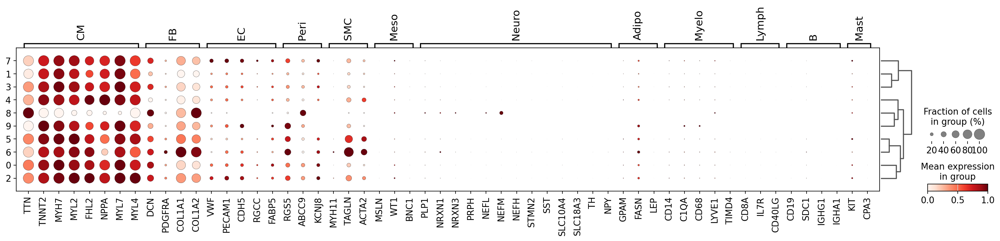

In [16]:
markers_others = {
    'CM': ['TTN', 'TNNT2','MYH6',
        'MYH7', 'MYL2', 'FHL2', # vCN
            'NPPA', 'MYL7', 'MYL4'], #aCM
    'FB': ['DCN', 'GCN', 'PDGFRA','COL1A1','COL1A2'],
    'EC': ['VWF', 'PECAM1', 'CDH5','RGCC', 'FABP5',],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3','PRPH', 'NEFL', 'NEFM', 'NEFH', 'STMN2', 'SST', 'SLC10A4', 'SLC18A3', 'TH', 'NPY'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers_others.keys():
    markers_others[key]=[x for x in markers_others[key] if x in adata.var_names]

sc.tl.dendrogram(adata, groupby=f'leiden_{str(resolution_sel)}')
sc.pl.dotplot(adata,
              markers_others, 
              groupby=f'leiden_{str(resolution_sel)}',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

categories: 0, 1, 2, etc.
var_group_labels: VCSprox, VCSdist, Trab, etc.


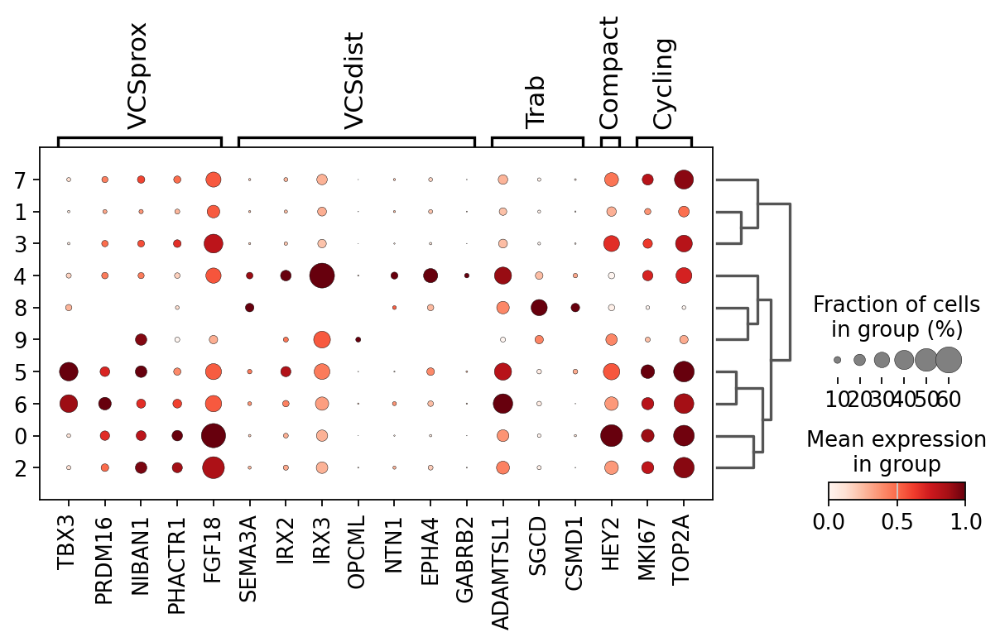

In [17]:
sc.tl.dendrogram(adata,groupby=f'leiden_{str(resolution_sel)}')
sc.pl.dotplot(adata,
              var_names=markers,
              groupby=f'leiden_{str(resolution_sel)}',
              standard_scale='var',
              dendrogram=True
             )

[1.47180343 1.33566585 1.26948215 1.24032132 1.26104042]


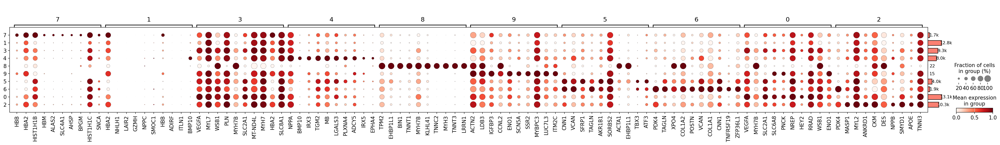

In [18]:
# DEG analysis
print(adata.X.data[:5])
adata.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata,groupby=f'leiden_{str(resolution_sel)}')
sc.tl.dendrogram(adata, groupby=f'leiden_{str(resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata, dendrogram=True, standard_scale='var', return_fig=True)
dp.add_totals().show()

[1.47180343 1.33566585 1.26948215 1.24032132 1.26104042]


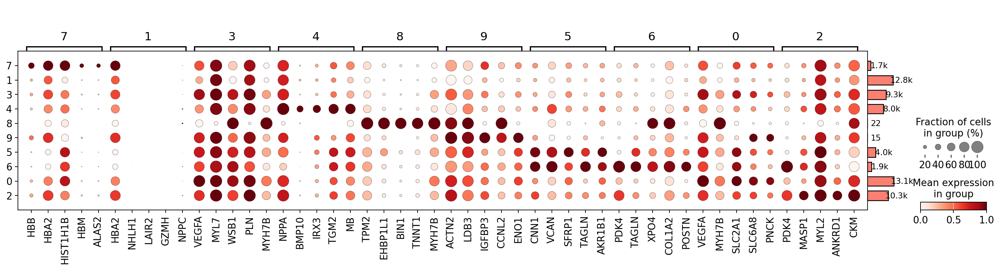

In [19]:
# DEG analysis
print(adata.X.data[:5])
adata.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata,groupby=f'leiden_{str(resolution_sel)}')
sc.tl.dendrogram(adata, groupby=f'leiden_{str(resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata, dendrogram=True, standard_scale='var', return_fig=True, n_genes=5)
dp.add_totals().show()

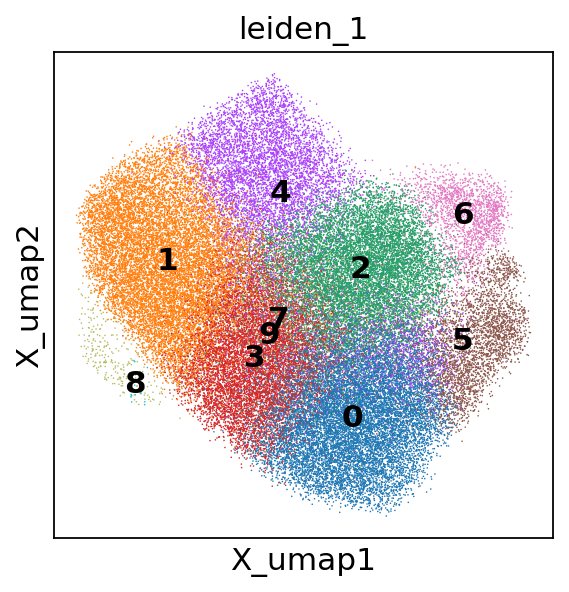

In [20]:
sc.pl.embedding(adata,basis='X_umap',
                color=f'leiden_{str(resolution_sel)}',
                wspace=0.3, legend_loc='on data')

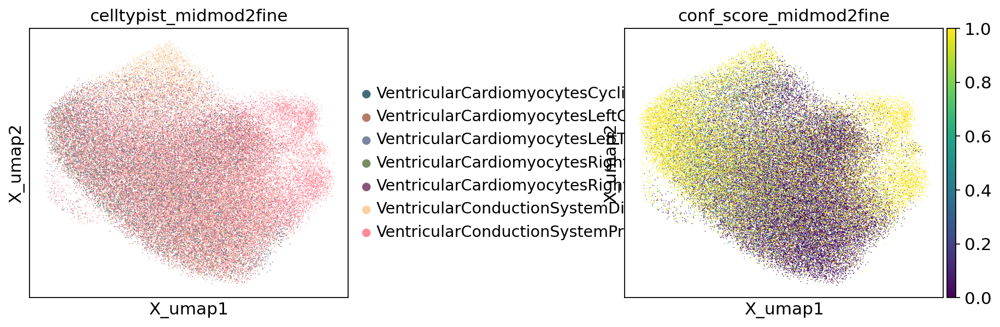

In [21]:
sc.pl.embedding(adata,basis='X_umap',
                color=['celltypist_midmod2fine', 'conf_score_midmod2fine'],
                wspace=0.7)

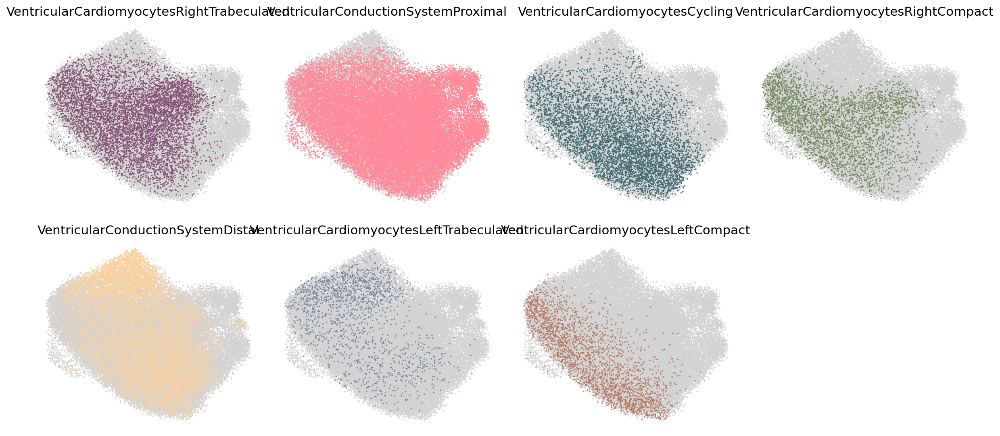

In [22]:
# umap per celltype to highlight
group_col = 'celltypist_midmod2fine'
groups_to_plot = list(set(adata.obs[group_col]))

plt.rcParams['axes.grid'] = False
fig,axs=plt.subplots(nrows=2,ncols=4,figsize=(15,7))
# Flatten the axs array for easier iteration in case of multiple rows and columns
axs_flat = axs.flatten()

for i,grp in enumerate(groups_to_plot):
    sc.pl.umap(adata, color=[group_col], groups=grp, 
               size=10, frameon=False,
               show=False, ax=axs_flat[i], legend_loc=None, legend_fontsize=5,
               title=grp
              )
# Turn off any remaining subplots
for j in range(len(groups_to_plot), len(axs_flat)):
    fig.delaxes(axs_flat[j])

# fig.suptitle('Main Title for the Figure')
fig.tight_layout()

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

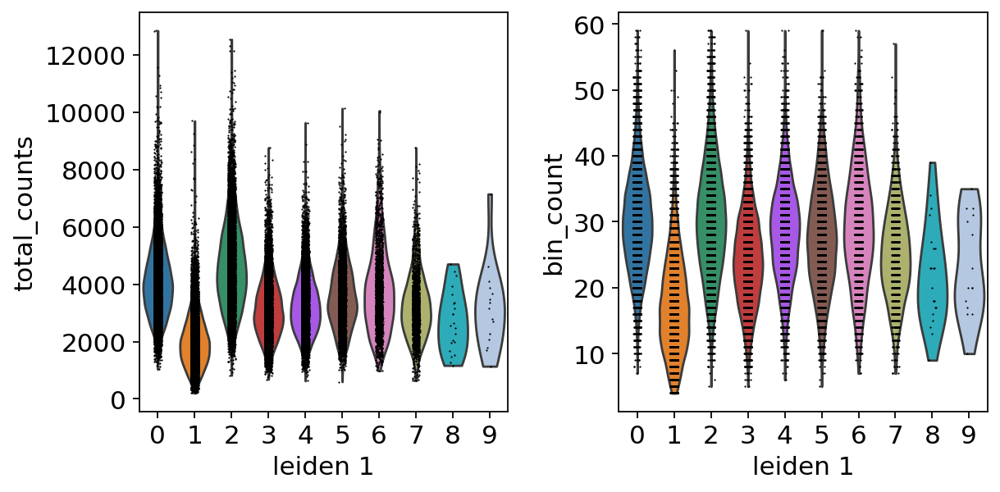

In [23]:
sc.pl.violin(adata,keys=['total_counts','bin_count'],groupby=f'leiden_{str(resolution_sel)}')

--> cluster 1 has low total_counts and bin_counts. and no specific marker expression --> will annotated as "unassigned"

In [24]:
# annotate
adata.obs['fine_grain_manual'] = adata.obs[f'leiden_{str(resolution_sel)}'].copy()
adata.obs.replace({'fine_grain_manual':{
    '0':'VentricularCardiomyocytesCompact',
    '1':'unassigned',
    '2':'uncertain',
    '3':'uncertain',
    '4':'uncertain',
    '5':'VentricularConductionSystemProximal',
    '6':'VentricularConductionSystemProximal',
    '7':'VentricularCardiomyocytes_DoubletsWithErythrocytes',
    '8':'VentricularCardiomyocytes_Doublets',
    '9':'uncertain',
}},inplace=True)
adata.obs['fine_grain_manual'].value_counts()

fine_grain_manual
uncertain                                             27579
VentricularCardiomyocytesCompact                      13082
unassigned                                            12767
VentricularConductionSystemProximal                    5902
VentricularCardiomyocytes_DoubletsWithErythrocytes     1723
VentricularCardiomyocytes_Doublets                       22
Name: count, dtype: int64

In [ ]:
'0':'VentricularCardiomyocytesCompact',
    '1':'VentricularCardiomyocytesCompact',
    '2':'VentricularCardiomyocytesTrabeculated',
    '3':'VentricularConductionSystem',

In [96]:
ad = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Feb28ObjectRaw_finegrain_updated.h5ad',backed='r')
set(ad.obs['fine_grain'])

{'AtrialCardiomyocytesCycling',
 'AtrialCardiomyocytesLeft',
 'AtrialCardiomyocytesRight',
 'AtrioventricularNodePacemakerCells',
 'BCells',
 'BCellsMS4A1pos',
 'ChromaffinCells',
 'CoronaryArterialEndothelialCells',
 'CoronaryCapillaryEndothelialCells',
 'CoronaryPericytes',
 'CoronarySmoothMuscleCells',
 'CoronaryVenousEndothelialCells',
 'CoronaryVesselAdventitialFibroblasts',
 'DendriticCellsMature',
 'DendriticCellsType1',
 'DuctusArteriosusSmoothMuscleCells',
 'EndocardialCells',
 'EndocardialCushionCells',
 'EpicardiumDerivedCells',
 'GreatVesselAdventitialFibroblasts',
 'GreatVesselArterialEndothelialCells',
 'GreatVesselSmoothMuscleCells',
 'GreatVesselVenousEndothelialCells',
 'InnateLymphoidCells',
 'LymphNodeFibroblasticReticularCells',
 'LymphaticEndothelialCells',
 'MacrophagesATF3pos',
 'MacrophagesCX3CR1pos',
 'MacrophagesLYVE1pos',
 'MacrophagesTIMD4pos',
 'MastCells',
 'Megakaryocytes',
 'MesothelialEpicardialCells',
 'MonocyteDerivedCells',
 'Monocytes',
 'MonocytesM

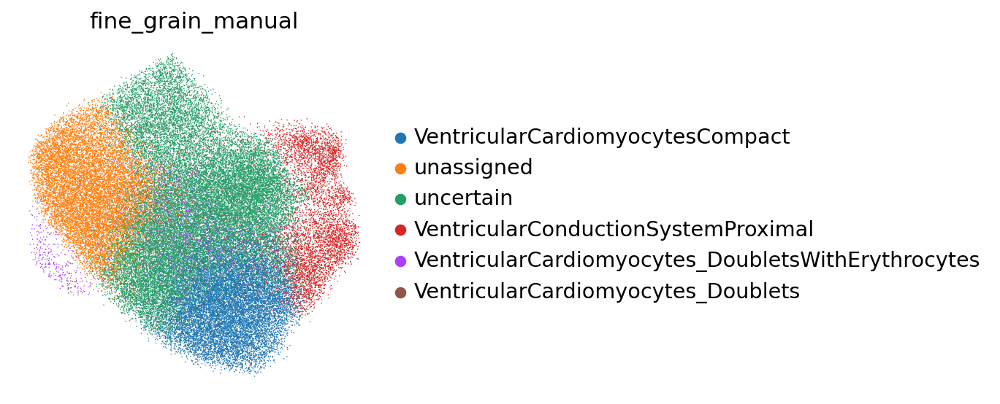

In [26]:
sc.pl.embedding(adata,basis='X_umap',
                color='fine_grain_manual',
                frameon=False,
                wspace=0.3)

categories: VentricularCardiomyocytesCompact, unassigned, uncertain, etc.
var_group_labels: VCSprox, VCSdist, Trab, etc.


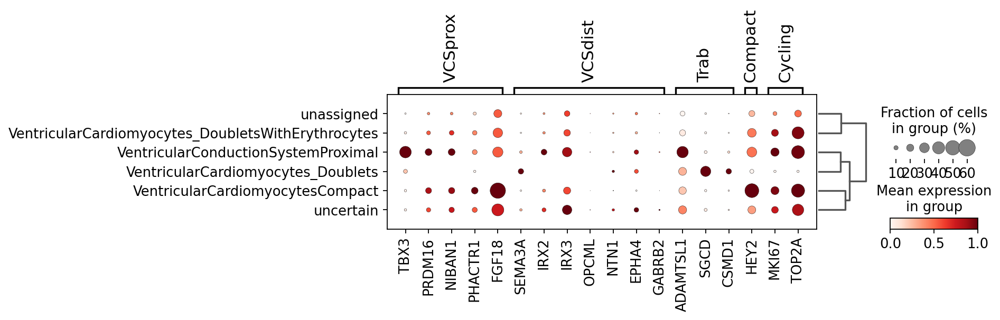

In [27]:
sc.tl.dendrogram(adata,groupby='fine_grain_manual')
sc.pl.dotplot(adata,
              var_names=markers,
              groupby='fine_grain_manual',
              standard_scale='var',
              dendrogram=True
             )

In [28]:
set(adata.obs['fine_grain_manual'])

{'VentricularCardiomyocytesCompact',
 'VentricularCardiomyocytes_Doublets',
 'VentricularCardiomyocytes_DoubletsWithErythrocytes',
 'VentricularConductionSystemProximal',
 'unassigned',
 'uncertain'}

# Subset "uncertain" cells

In [29]:
adata_sub = adata[adata.obs['fine_grain_manual'].isin(['uncertain'])]

# drop leiden clustering results
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    adata_sub.obs.drop(f'leiden_{str(resolution)}',axis=1,inplace=True)
adata_sub

AnnData object with n_obs × n_vars = 27579 × 17994
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'fine_grain_manual'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'celltypist_coarse_colors', 'celltypist_coarse_fin_colors', 'celltypist_mid_fin_colors'

In [30]:
# remove mid_grain markers
mask = [x not in list(midgrain_markers['names']) for x in adata_sub.var_names]
bdata = adata_sub[:,mask]
bdata

View of AnnData object with n_obs × n_vars = 27579 × 16746
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'fine_grain_manual'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'celltypist_coarse_colors', 'celltypist_coarse_fin_colors', 'celltypist_mid_fin

In [31]:
# HVGs, using the object which doesn't have midgrain markers
sc.pp.highly_variable_genes(bdata, flavor='seurat', min_mean=0.0125, max_mean=3, min_disp=0.5)
print(f'number of hvgs: {sum(bdata.var.highly_variable)}')
# PCA using the degected HVGs
sc.tl.pca(bdata, use_highly_variable=True)
adata_sub.obsm['X_pca'] = bdata.obsm['X_pca'].copy()
# create neighbour graph
sc.pp.neighbors(adata_sub,n_neighbors=15,use_rep='X_pca')

number of hvgs: 2182


In [32]:
sc.tl.umap(adata_sub,min_dist=0.1)

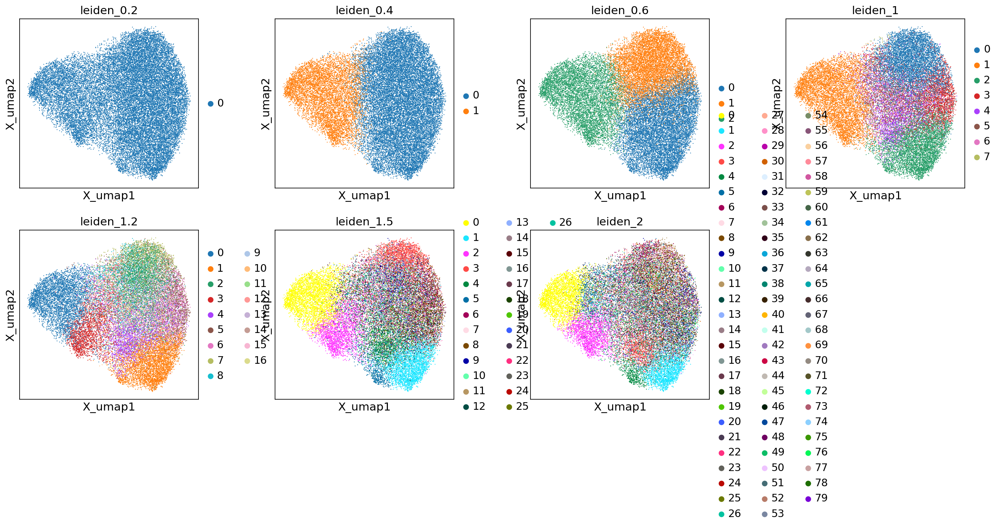

CPU times: user 17.1 s, sys: 466 ms, total: 17.5 s
Wall time: 18.1 s


In [33]:
%%time
# reclustering
# leiden clustering
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    sc.tl.leiden(adata_sub,resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
sc.pl.embedding(adata_sub,basis='X_umap',
                color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                wspace=0.3)

In [34]:
markers = {
    # 'VCSprox':['TBX3','PRDM16','NIBAN1','PHACTR1','FGF18'], # 'PRDM16','NIBAN1','PHACTR1','FGF18' are the markers compared to VCSdistal
    'VCSdist':['SEMA3A','IRX2','IRX3','OPCML','NTN1','EPHA4','GABRB2'],
    'Trab':['ADAMTSL1','SGCD','CSMD1'],
    'Compact':['TBX20','HEY2'],
    'Cycling':['MKI67','TOP2A']
}

genes = []
for g in markers.values():
    genes = genes + [x for x in g if (x in adata.var_names)&(x not in genes)]
for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]
len(genes)

13

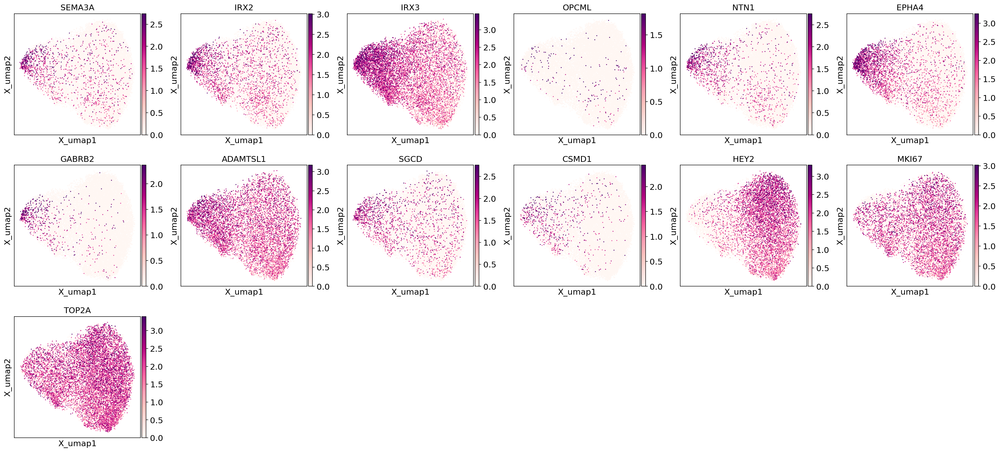

In [35]:
sc.pl.embedding(adata_sub,basis='X_umap',color=genes, size=10,
               ncols=6, wspace=0.2,cmap='RdPu',vmax='p99.7')

In [36]:
adata_sub_resolution_sel = 0.6

categories: 0, 1, 2
var_group_labels: CM, FB, EC, etc.


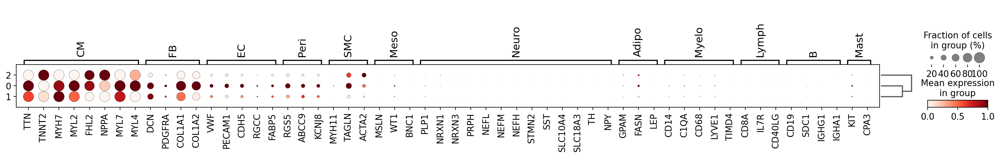

In [37]:
markers_others = {
    'CM': ['TTN', 'TNNT2','MYH6',
        'MYH7', 'MYL2', 'FHL2', # vCN
            'NPPA', 'MYL7', 'MYL4'], #aCM
    'FB': ['DCN', 'GCN', 'PDGFRA','COL1A1','COL1A2'],
    'EC': ['VWF', 'PECAM1', 'CDH5','RGCC', 'FABP5',],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3','PRPH', 'NEFL', 'NEFM', 'NEFH', 'STMN2', 'SST', 'SLC10A4', 'SLC18A3', 'TH', 'NPY'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers_others.keys():
    markers_others[key]=[x for x in markers_others[key] if x in adata_sub.var_names]

sc.tl.dendrogram(adata_sub, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub,
              markers_others, 
              groupby=f'leiden_{str(adata_sub_resolution_sel)}',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

categories: 0, 1, 2
var_group_labels: VCSdist, Trab, Compact, etc.


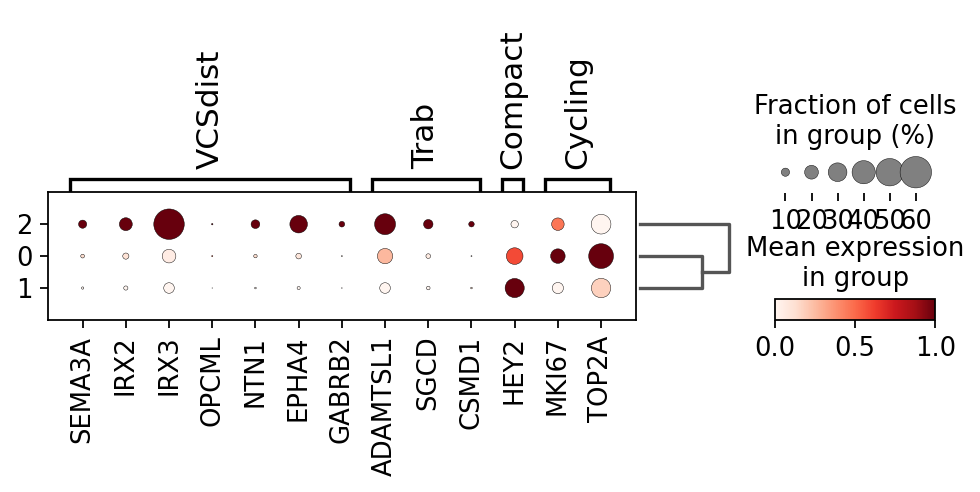

In [38]:
sc.tl.dendrogram(adata_sub,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub,
              var_names=markers,
              groupby=f'leiden_{str(adata_sub_resolution_sel)}',
              standard_scale='var',
              dendrogram=True
             )

[2.16681224 1.99582797 1.93329773 1.91105105 1.8337824 ]


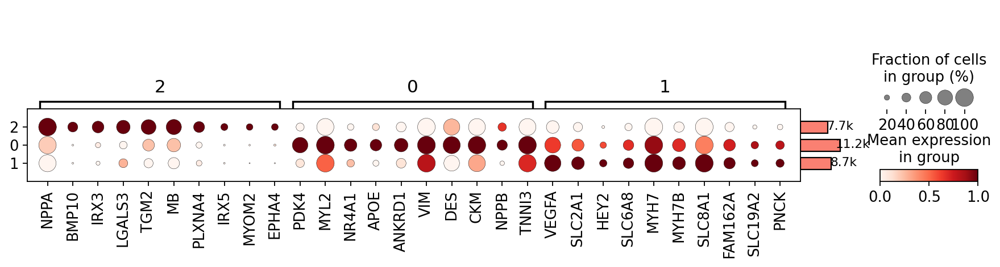

In [39]:
# DEG analysis
print(adata_sub.X.data[:5])
adata_sub.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_sub,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.tl.dendrogram(adata_sub, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata_sub, dendrogram=True, standard_scale='var', return_fig=True)
dp.add_totals().show()

[2.16681224 1.99582797 1.93329773 1.91105105 1.8337824 ]


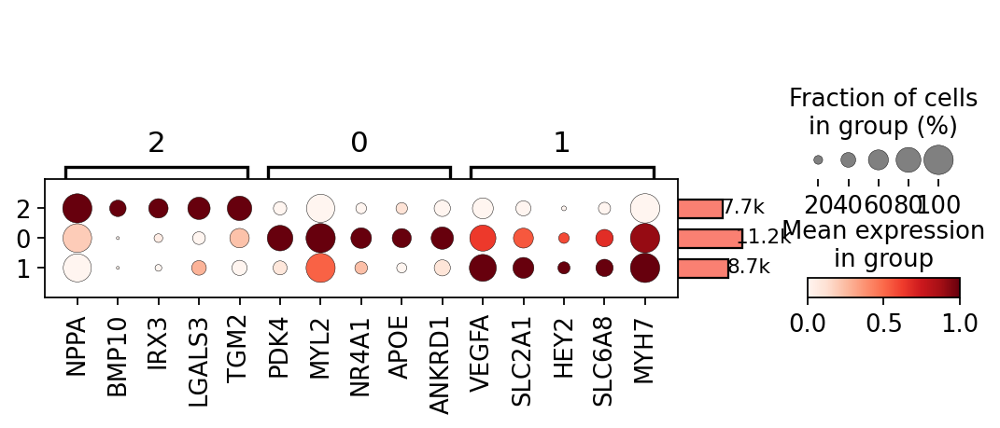

In [40]:
# DEG analysis
print(adata_sub.X.data[:5])
adata_sub.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_sub,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.tl.dendrogram(adata_sub, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata_sub, dendrogram=True, standard_scale='var', return_fig=True, n_genes=5)
dp.add_totals().show()

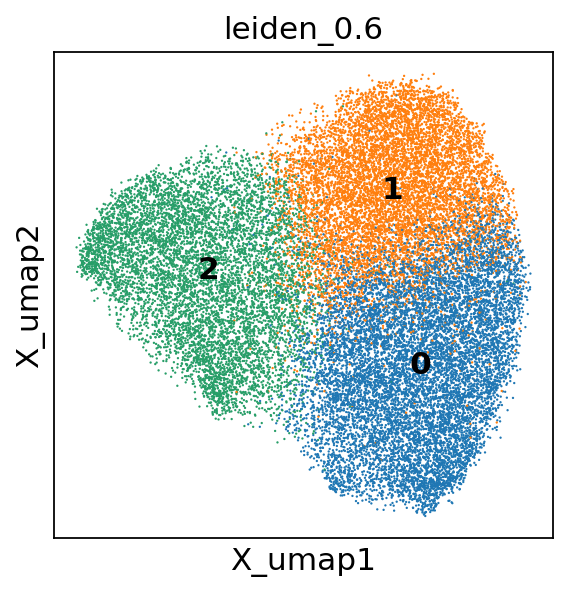

In [41]:
sc.pl.embedding(adata_sub,basis='X_umap',
                color=f'leiden_{str(adata_sub_resolution_sel)}',
                wspace=0.3, legend_loc='on data')

In [42]:
# annotate
adata_sub.obs['fine_grain_manual'] = adata_sub.obs[f'leiden_{str(adata_sub_resolution_sel)}'].copy()
adata_sub.obs.replace({'fine_grain_manual':{
    '0':'VentricularCardiomyocytesCompact', # cluster 0 has more FB and vasculature signatures compared to cluster 1. Potentially there's some level of contamination. Which also suggests these population are more close to FB/Vasc.
    '1':'VentricularCardiomyocytesCompact',
    '2':'VentricularConductionSystemDistal_VentricularCardiomyocytesTrabeculated',
}},inplace=True)
adata_sub.obs['fine_grain_manual'].value_counts()

fine_grain_manual
VentricularCardiomyocytesCompact                                           19888
VentricularConductionSystemDistal_VentricularCardiomyocytesTrabeculated     7691
Name: count, dtype: int64

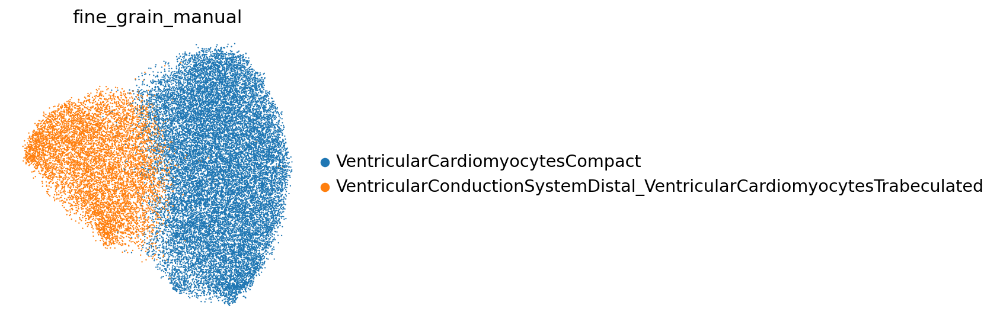

In [43]:
sc.pl.embedding(adata_sub,basis='X_umap',
                color='fine_grain_manual',
                frameon=False,
                wspace=0.3)

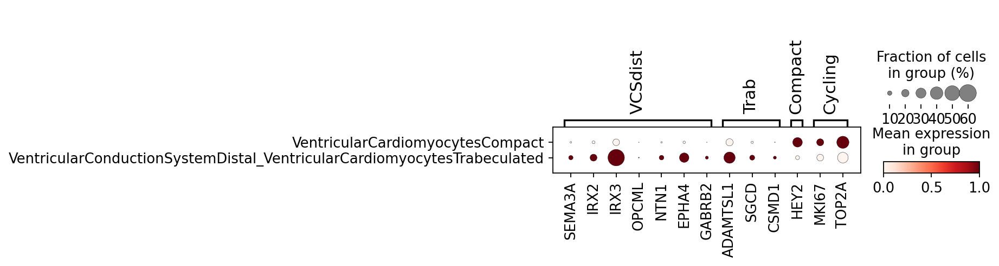

In [44]:
sc.tl.dendrogram(adata_sub,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub,
              var_names=markers,
              groupby='fine_grain_manual',
              standard_scale='var',
              dendrogram=True
             )

# Subset uncertain cells - 2nd round

* To identify VCS-distal

In [45]:
adata_sub2 = adata_sub[adata_sub.obs['fine_grain_manual'].isin(['VentricularConductionSystemDistal_VentricularCardiomyocytesTrabeculated'])]

# drop leiden clustering results
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    adata_sub2.obs.drop(f'leiden_{str(resolution)}',axis=1,inplace=True)
adata_sub2

AnnData object with n_obs × n_vars = 7691 × 17994
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'fine_grain_manual'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'celltypist_coarse_colors', 'celltypist_coarse_fin_colors', 'celltypist_mid_fin_colors',

In [46]:
# remove mid_grain markers
mask = [x not in list(midgrain_markers['names']) for x in adata_sub2.var_names]
bdata = adata_sub2[:,mask]
bdata

View of AnnData object with n_obs × n_vars = 7691 × 16746
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'fine_grain_manual'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltypist_coarse2midmod_colors', 'celltypist_coarse_colors', 'celltypist_coarse_fin_colors', 'celltypist_mid_fin_

In [47]:
# HVGs, using the object which doesn't have midgrain markers
sc.pp.highly_variable_genes(bdata, flavor='seurat', min_mean=0.0125, max_mean=3, min_disp=0.5)
print(f'number of hvgs: {sum(bdata.var.highly_variable)}')
# PCA using the degected HVGs
sc.tl.pca(bdata, use_highly_variable=True)
adata_sub2.obsm['X_pca'] = bdata.obsm['X_pca'].copy()
# create neighbour graph
sc.pp.neighbors(adata_sub2,n_neighbors=15,use_rep='X_pca')

number of hvgs: 3227


In [48]:
sc.tl.umap(adata_sub2,min_dist=0.1)

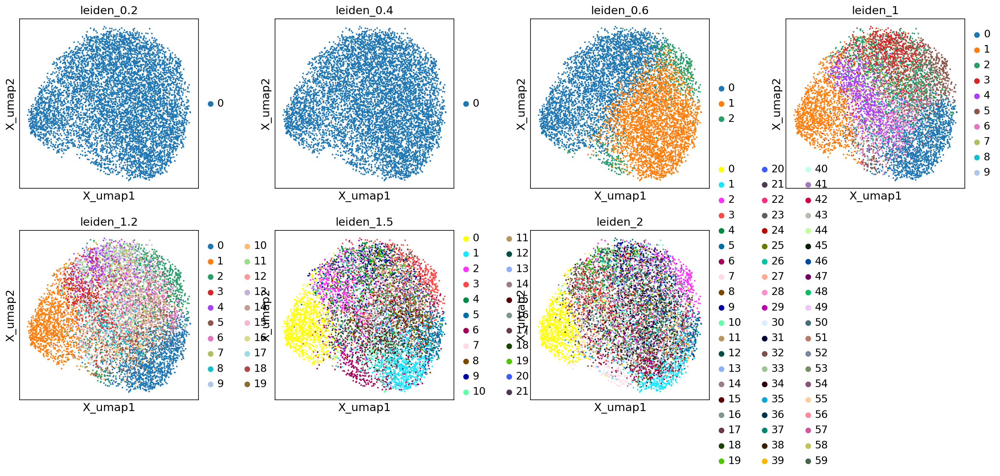

CPU times: user 6.04 s, sys: 148 ms, total: 6.19 s
Wall time: 6.37 s


In [50]:
%%time
# reclustering
# leiden clustering
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    sc.tl.leiden(adata_sub2,resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
sc.pl.embedding(adata_sub2,basis='X_umap',
                color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                wspace=0.3)

In [68]:
markers = {
    # 'VCSprox':['TBX3','PRDM16','NIBAN1','PHACTR1','FGF18'], # 'PRDM16','NIBAN1','PHACTR1','FGF18' are the markers compared to VCSdistal
    'VCSdist':['SEMA3A','IRX2','IRX3','OPCML','NTN1','EPHA4','GABRB2'],
    # 'Trab':['ADAMTSL1','SGCD','CSMD1'],
    # 'Compact':['TBX20','HEY2'],
    'Cycling':['MKI67','TOP2A']
}

genes = []
for g in markers.values():
    genes = genes + [x for x in g if (x in adata_sub2.var_names)&(x not in genes)]
for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata_sub2.var_names]
len(genes)

9

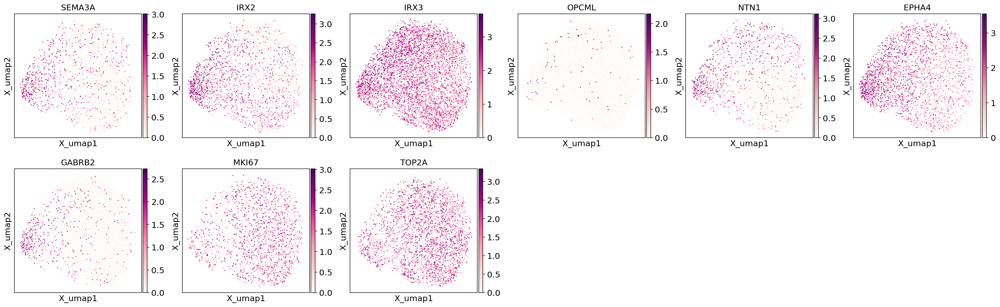

In [69]:
sc.pl.embedding(adata_sub2,basis='X_umap',color=genes, size=10,
               ncols=6, wspace=0.2,cmap='RdPu',vmax='p99.7')

In [53]:
adata_sub_resolution_sel = 1

categories: 0, 1, 2, etc.
var_group_labels: CM, FB, EC, etc.


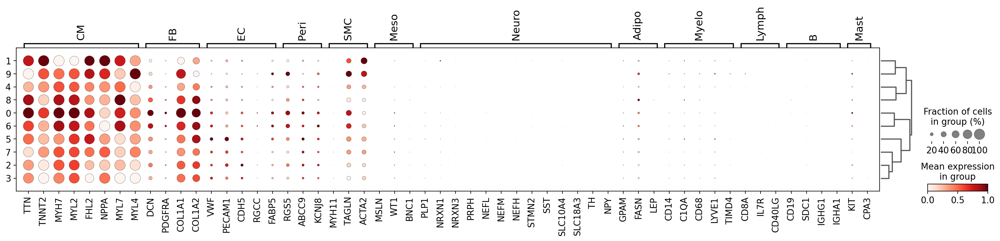

In [56]:
markers_others = {
    'CM': ['TTN', 'TNNT2','MYH6',
        'MYH7', 'MYL2', 'FHL2', # vCN
            'NPPA', 'MYL7', 'MYL4'], #aCM
    'FB': ['DCN', 'GCN', 'PDGFRA','COL1A1','COL1A2'],
    'EC': ['VWF', 'PECAM1', 'CDH5','RGCC', 'FABP5',],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3','PRPH', 'NEFL', 'NEFM', 'NEFH', 'STMN2', 'SST', 'SLC10A4', 'SLC18A3', 'TH', 'NPY'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers_others.keys():
    markers_others[key]=[x for x in markers_others[key] if x in adata_sub2.var_names]

sc.tl.dendrogram(adata_sub2, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub2,
              markers_others, 
              groupby=f'leiden_{str(adata_sub_resolution_sel)}',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

categories: 0, 1, 2, etc.
var_group_labels: VCSdist, Cycling


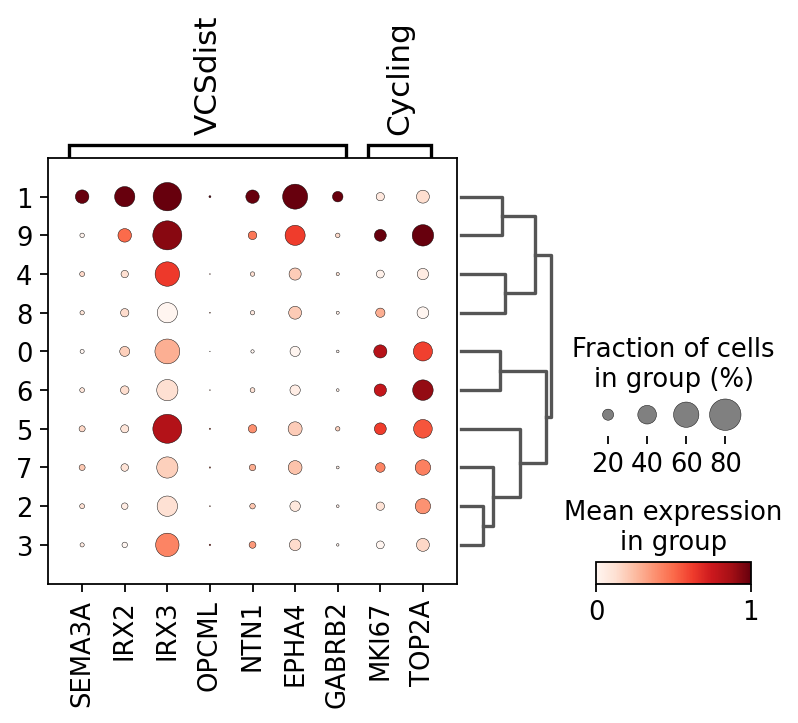

In [70]:
sc.tl.dendrogram(adata_sub2,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub2,
              var_names=markers,
              groupby=f'leiden_{str(adata_sub_resolution_sel)}',
              standard_scale='var',
              dendrogram=True
             )

--> cluster 1 looks like VCS-distal

[2.71216227 1.03967184 1.35760811 1.70411582 1.28981545]


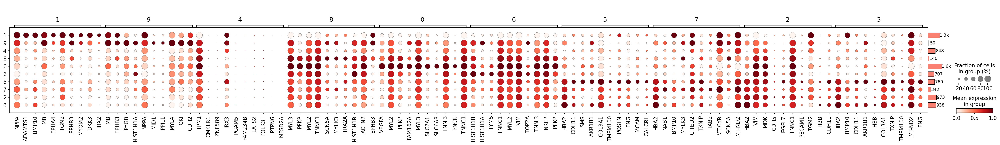

In [59]:
# DEG analysis
print(adata_sub2.X.data[:5])
adata_sub2.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_sub2,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.tl.dendrogram(adata_sub2, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata_sub2, dendrogram=True, standard_scale='var', return_fig=True)
dp.add_totals().show()

[2.71216227 1.03967184 1.35760811 1.70411582 1.28981545]


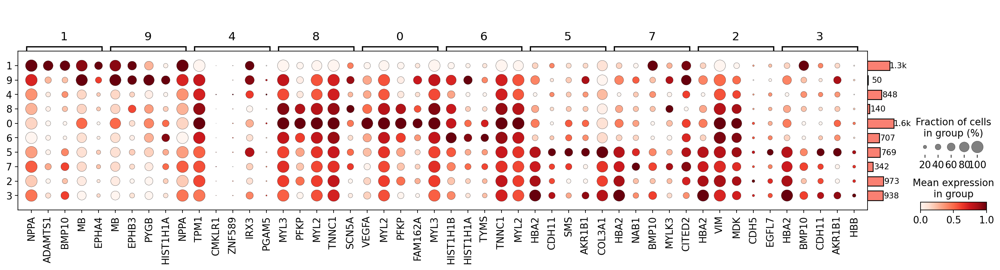

In [60]:
# DEG analysis
print(adata_sub2.X.data[:5])
adata_sub2.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_sub2,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.tl.dendrogram(adata_sub2, groupby=f'leiden_{str(adata_sub_resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata_sub2, dendrogram=True, standard_scale='var', return_fig=True, n_genes=5)
dp.add_totals().show()

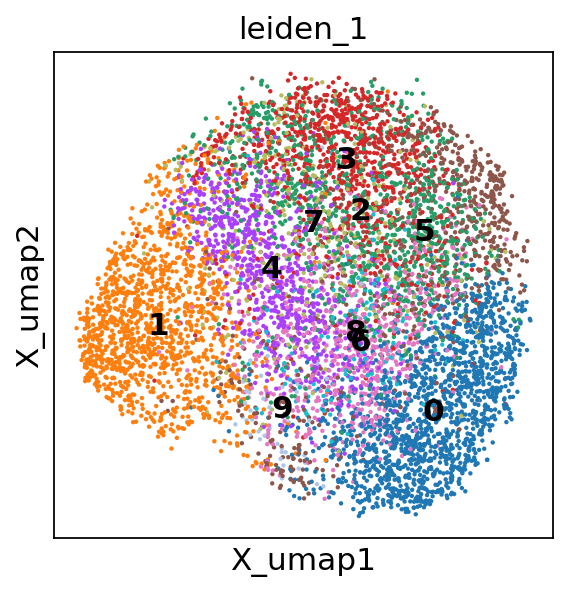

In [62]:
sc.pl.embedding(adata_sub2,basis='X_umap',
                color=f'leiden_{str(adata_sub_resolution_sel)}',
                wspace=0.3, legend_loc='on data')

In [63]:
# annotate
adata_sub2.obs['fine_grain_manual'] = adata_sub2.obs[f'leiden_{str(adata_sub_resolution_sel)}'].copy()
adata_sub2.obs.replace({'fine_grain_manual':{
    '0':'VentricularCardiomyocytesTrabeculated',
    '1':'VentricularConductionSystemDistal',
    '2':'VentricularCardiomyocytesTrabeculated',
    '3':'VentricularCardiomyocytesTrabeculated',
    '4':'VentricularCardiomyocytesTrabeculated',
    '5':'VentricularCardiomyocytesTrabeculated',
    '6':'VentricularCardiomyocytesTrabeculated',
    '7':'VentricularCardiomyocytesTrabeculated',
    '8':'VentricularCardiomyocytesTrabeculated',
    '9':'VentricularCardiomyocytesTrabeculated',
}},inplace=True)
adata_sub2.obs['fine_grain_manual'].value_counts()

fine_grain_manual
VentricularCardiomyocytesTrabeculated    6349
VentricularConductionSystemDistal        1342
Name: count, dtype: int64

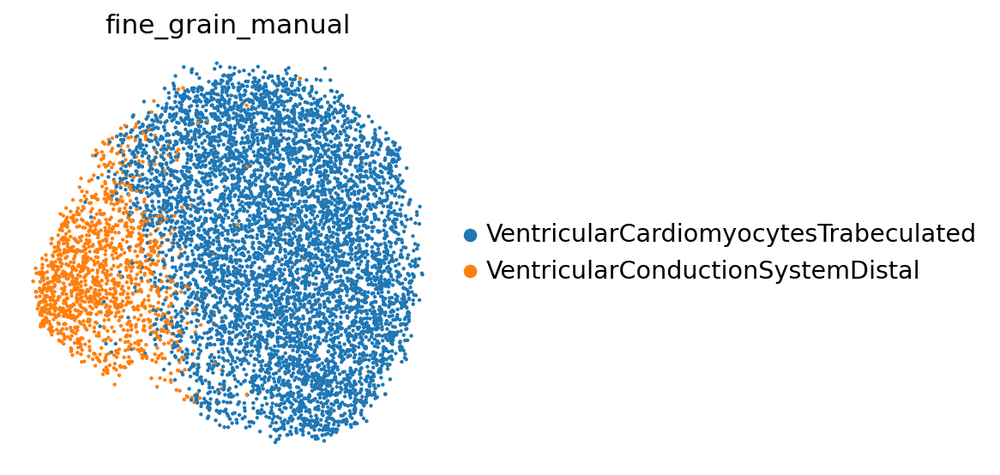

In [64]:
sc.pl.embedding(adata_sub2,basis='X_umap',
                color='fine_grain_manual',
                frameon=False,
                wspace=0.3)

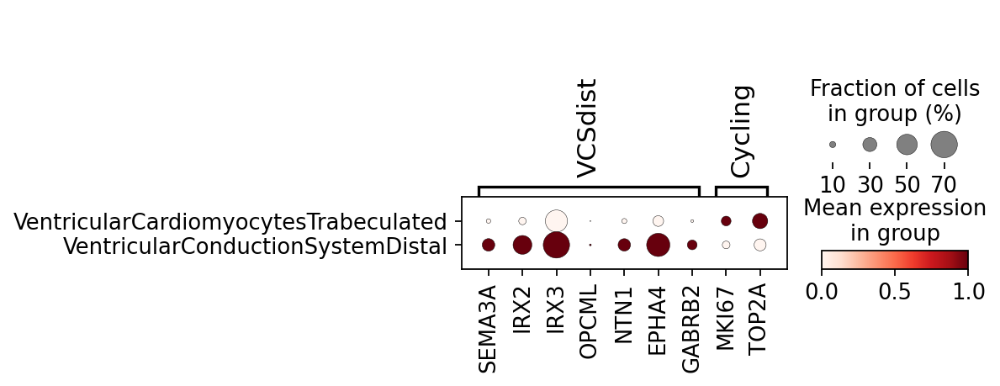

In [71]:
sc.tl.dendrogram(adata_sub2,groupby=f'leiden_{str(adata_sub_resolution_sel)}')
sc.pl.dotplot(adata_sub2,
              var_names=markers,
              groupby='fine_grain_manual',
              standard_scale='var',
              dendrogram=True
             )

# Add the annotation to the original adata

In [72]:
# add the annotation to the original adata
adata.obs['fine_grain_manual'] = adata.obs['fine_grain_manual'].astype('str')
adata.obs.loc[adata_sub.obs_names,'fine_grain_manual'] = adata_sub.obs['fine_grain_manual'].astype('str').copy()
adata.obs.loc[adata_sub2.obs_names,'fine_grain_manual'] = adata_sub2.obs['fine_grain_manual'].astype('str').copy()
adata.obs['fine_grain_manual'].value_counts()

fine_grain_manual
VentricularCardiomyocytesCompact                      32970
unassigned                                            12767
VentricularCardiomyocytesTrabeculated                  6349
VentricularConductionSystemProximal                    5902
VentricularCardiomyocytes_DoubletsWithErythrocytes     1723
VentricularConductionSystemDistal                      1342
VentricularCardiomyocytes_Doublets                       22
Name: count, dtype: int64

... storing 'fine_grain_manual' as categorical


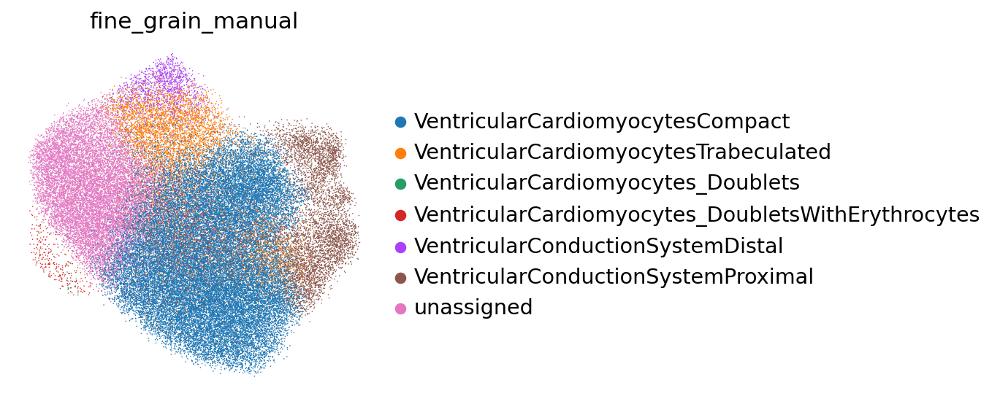

In [73]:
sc.pl.embedding(adata,basis='X_umap',
                color='fine_grain_manual',
                frameon=False,
                wspace=0.3)

In [74]:
markers = {
    'VCSprox':['TBX3','PRDM16','NIBAN1','PHACTR1','FGF18'], # 'PRDM16','NIBAN1','PHACTR1','FGF18' are the markers compared to VCSdistal
    'VCSdist':['SEMA3A','IRX2','IRX3','OPCML','NTN1','EPHA4','GABRB2'],
    'Trab':['ADAMTSL1','SGCD','CSMD1'],
    'Compact':['TBX20','HEY2'],
    'Cycling':['MKI67','TOP2A']
}

genes = []
for g in markers.values():
    genes = genes + [x for x in g if (x in adata_sub2.var_names)&(x not in genes)]
for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata_sub2.var_names]
len(genes)

18

categories: VentricularCardiomyocytesCompact, VentricularCardiomyocytesTrabeculated, VentricularCardiomyocytes_Doublets, etc.
var_group_labels: VCSprox, VCSdist, Trab, etc.


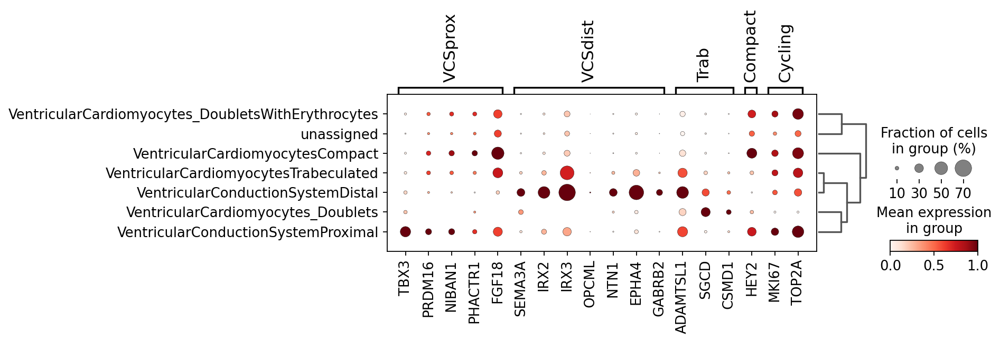

In [75]:
sc.tl.dendrogram(adata,groupby='fine_grain_manual')
sc.pl.dotplot(adata,
              var_names=markers,
              groupby='fine_grain_manual',
              standard_scale='var',
              dendrogram=True
             )

# Save

In [76]:
# save
adata.write(f'{adata_dir}/{sample_id}_{celltype}_b2c_cells_filtered_lognorm.h5ad')
print(f'{adata_dir}/{sample_id}_{celltype}_b2c_cells_filtered_lognorm.h5ad')

/lustre/scratch126/cellgen/team205/kk18/VisiumHD/objects/subsets/HEA_FOET14880396_VentricularCardiomyocytes_b2c_cells_filtered_lognorm.h5ad
